# 7월 18일 발표자료

# `-` **절삭품 사진**

## `-` **마모**

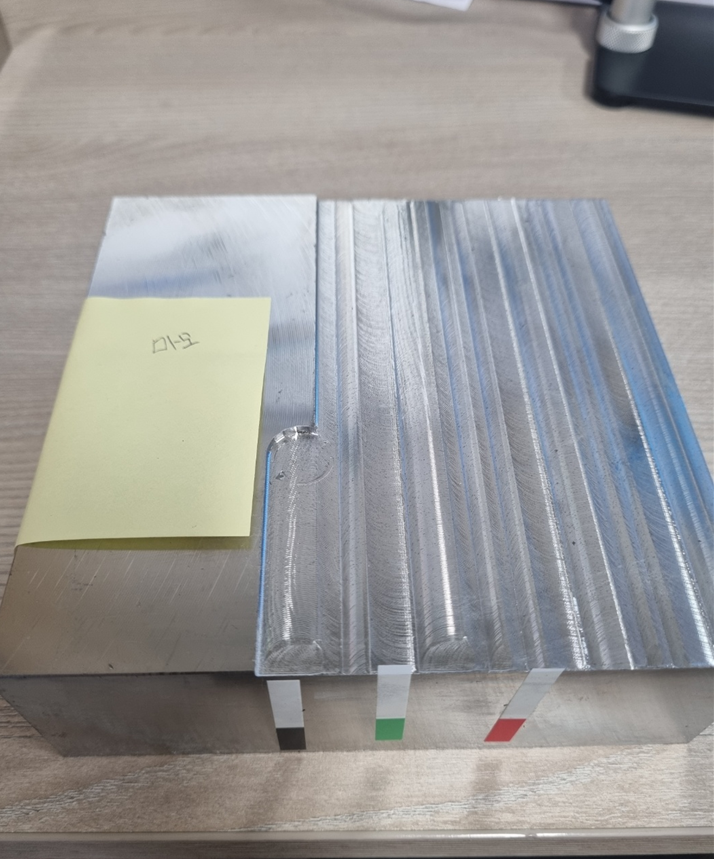

## `-` **정상**

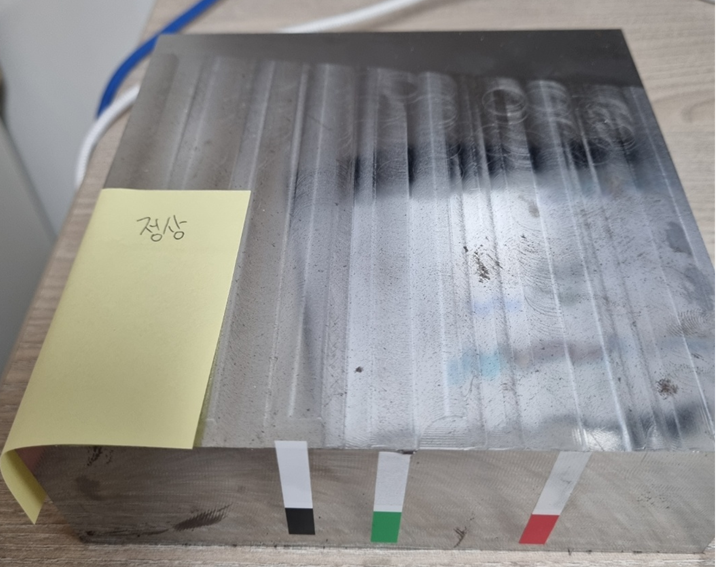

### `-` **마모 절삭품 Black Line**

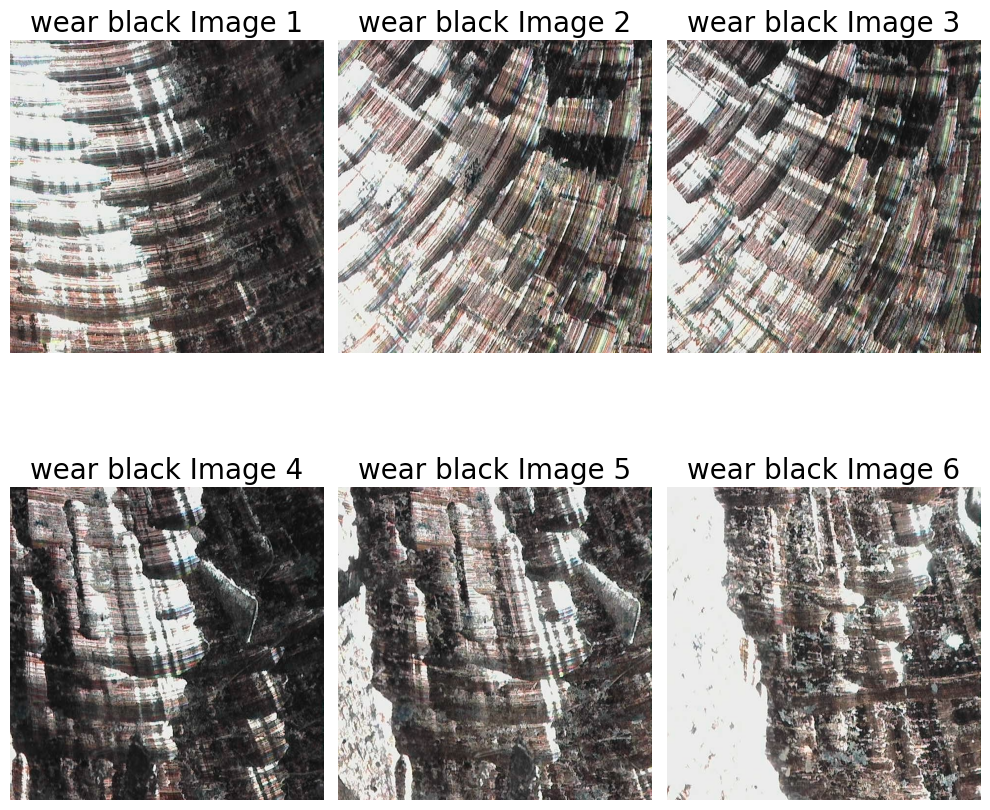

In [21]:
fig, axes = plt.subplots(2, 3, figsize=(10, 10))

# 이미지 개수에 맞춰 서브플롯에 이미지 표시
for i in range(len(wear_images)):
    row = i // 3
    col = i % 3
    
    if i >= 6:
        break
    
    axes[row, col].imshow(wear_images[i], extent=[0, 10, 0, 10])
    axes[row, col].set_title(f'wear black Image {i+1}',fontsize=20)
    axes[row, col].axis('off')

plt.tight_layout()
plt.show()


### `-` **정상 절삭품 Black Line**

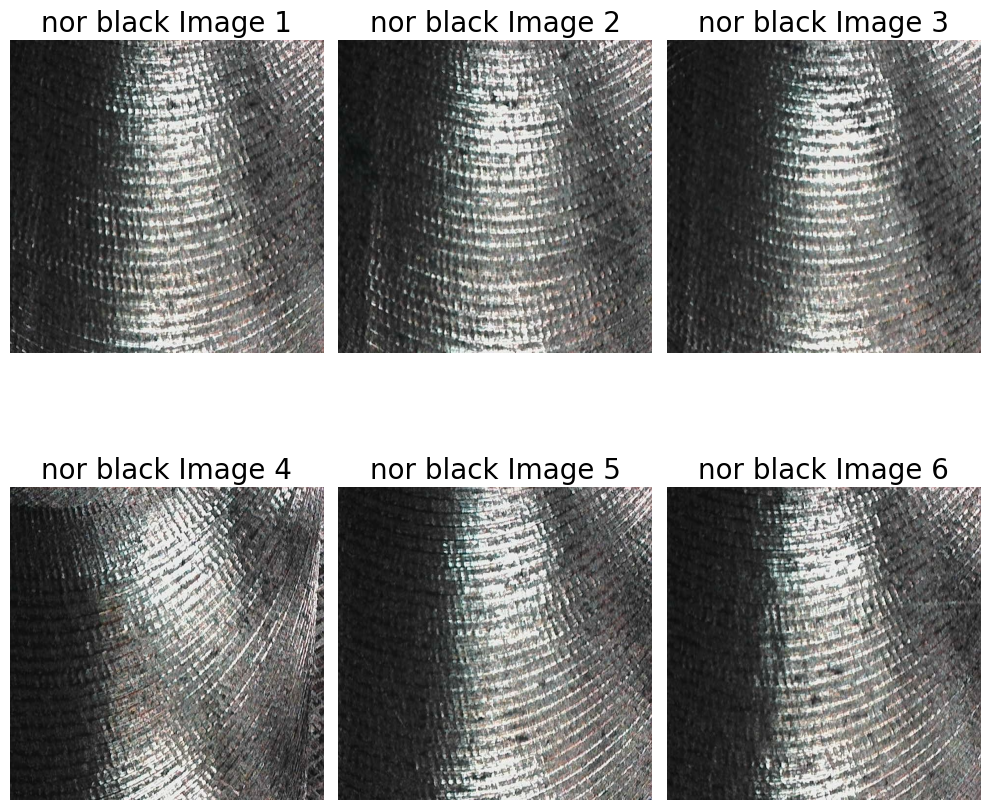

In [24]:
fig, axes = plt.subplots(2, 3, figsize=(10, 10))

# 이미지 개수에 맞춰 서브플롯에 이미지 표시
for i in range(len(nor_images)):
    row = i // 3
    col = i % 3
    
    if i >= 6:
        break
    
    axes[row, col].imshow(nor_images[i], extent=[0, 10, 0, 10])
    axes[row, col].set_title(f'nor black Image {i+1}',fontsize=20)
    axes[row, col].axis('off')

plt.tight_layout()
plt.show()


### `-` **마모 절삭품 Green Line**

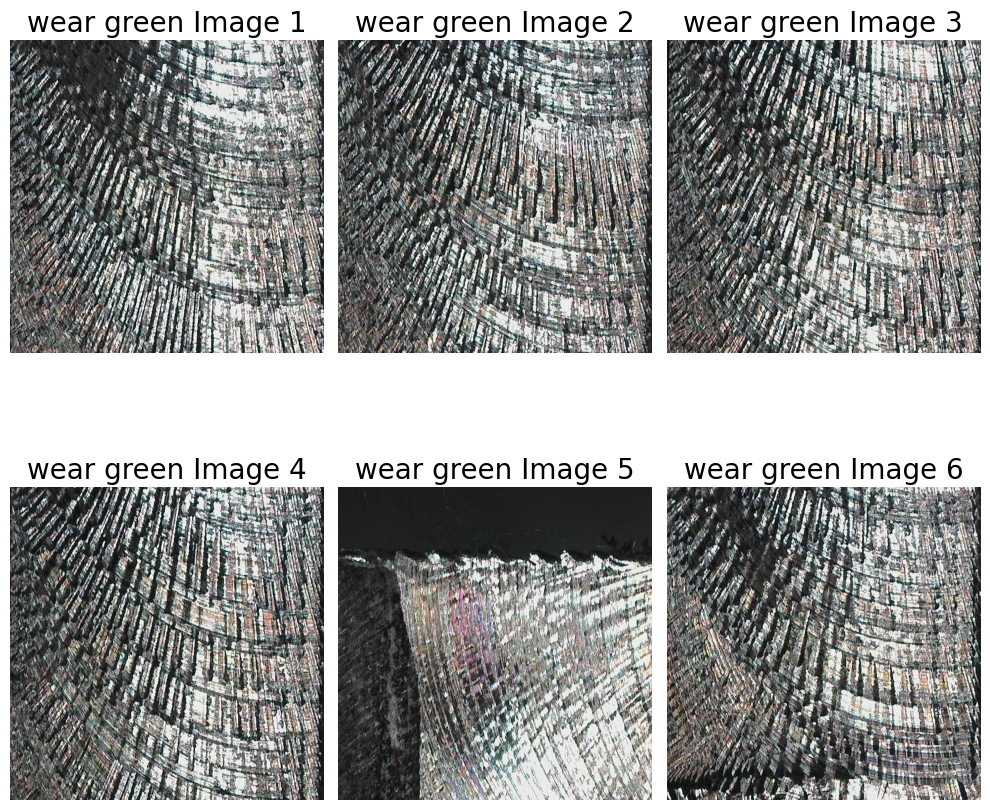

In [25]:
fig, axes = plt.subplots(2, 3, figsize=(10, 10))

# 이미지 개수에 맞춰 서브플롯에 이미지 표시
for i in range(len(wear_images)):
    row = i // 3
    col = i % 3
    
    
    if i >= 6:
        break
    
    axes[row, col].imshow(wear_images[i+6], extent=[0, 10, 0, 10])
    axes[row, col].set_title(f'wear green Image {i+1}',fontsize=20)
    axes[row, col].axis('off')

plt.tight_layout()
plt.show()

### `-` **정상 절삭품 Green Line**

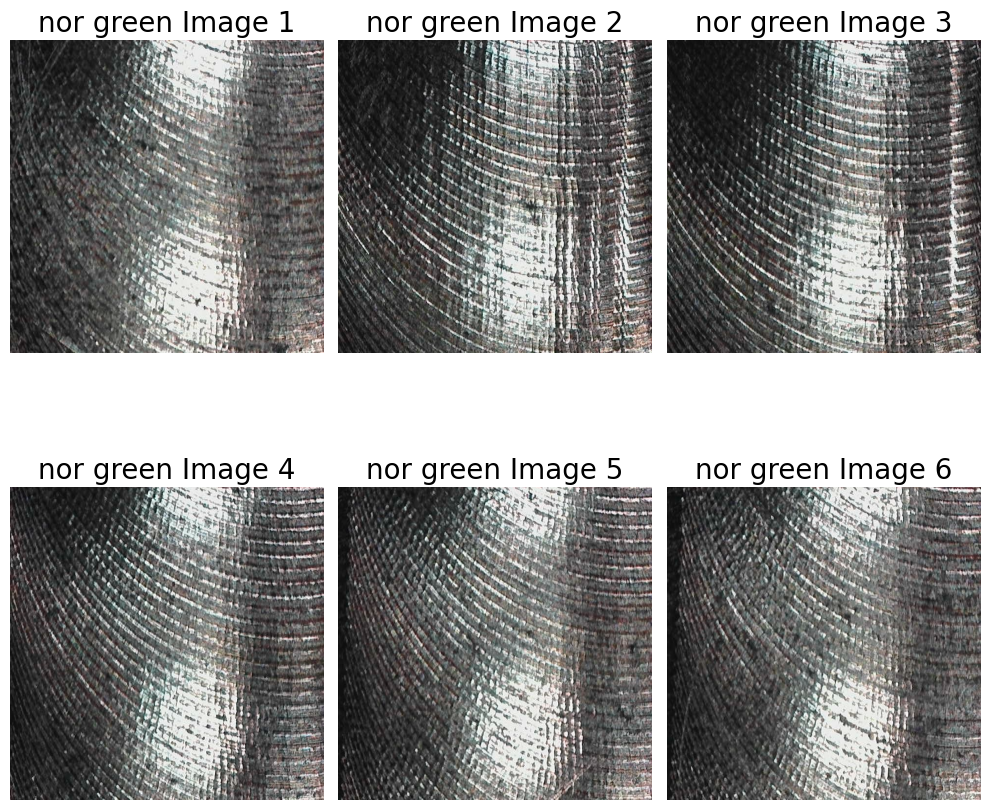

In [26]:
fig, axes = plt.subplots(2, 3, figsize=(10, 10))

# 이미지 개수에 맞춰 서브플롯에 이미지 표시
for i in range(len(wear_images)):
    row = i // 3
    col = i % 3
    
    if i >= 6:
        break
    
    axes[row, col].imshow(nor_images[i+6], extent=[0, 10, 0, 10])
    axes[row, col].set_title(f'nor green Image {i+1}',fontsize=20)
    axes[row, col].axis('off')

plt.tight_layout()
plt.show()

### `-` **마모 절삭품 Red Line**

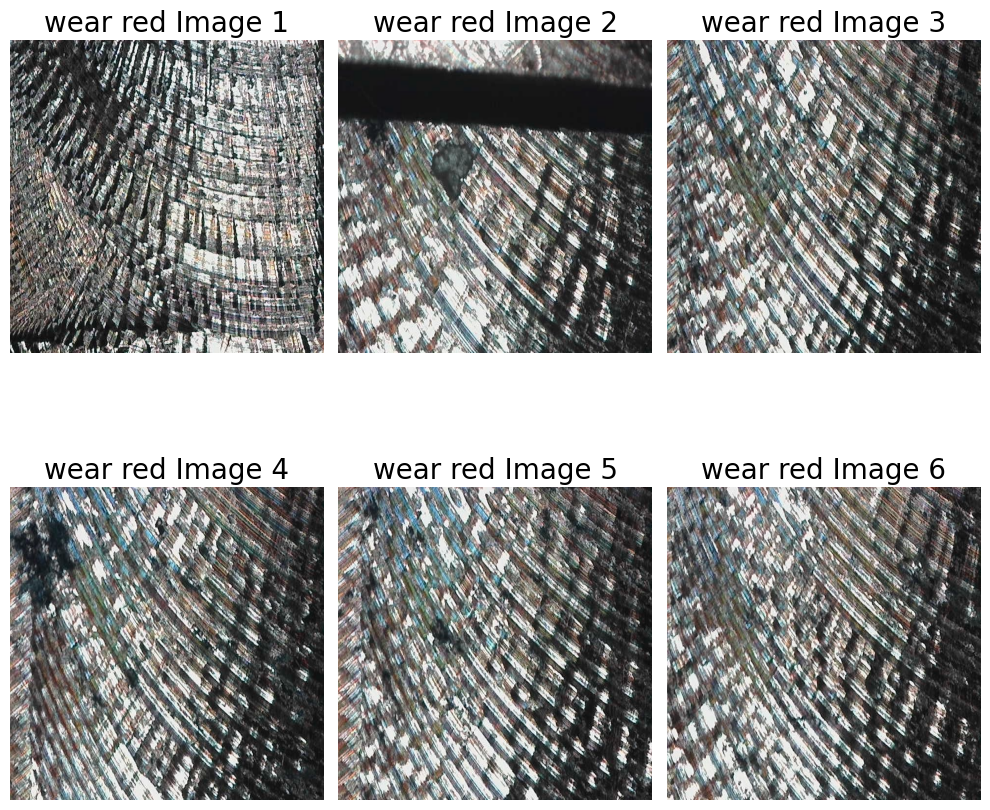

In [27]:
fig, axes = plt.subplots(2, 3, figsize=(10, 10))

# 이미지 개수에 맞춰 서브플롯에 이미지 표시
for i in range(len(wear_images)):
    row = i // 3
    col = i % 3
    
    if i >= 6:
        break
    
    axes[row, col].imshow(wear_images[i+12], extent=[0, 10, 0, 10])
    axes[row, col].set_title(f'wear red Image {i+1}',fontsize=20)
    axes[row, col].axis('off')

plt.tight_layout()
plt.show()

### `-` **정상 절삭품 Red Line**

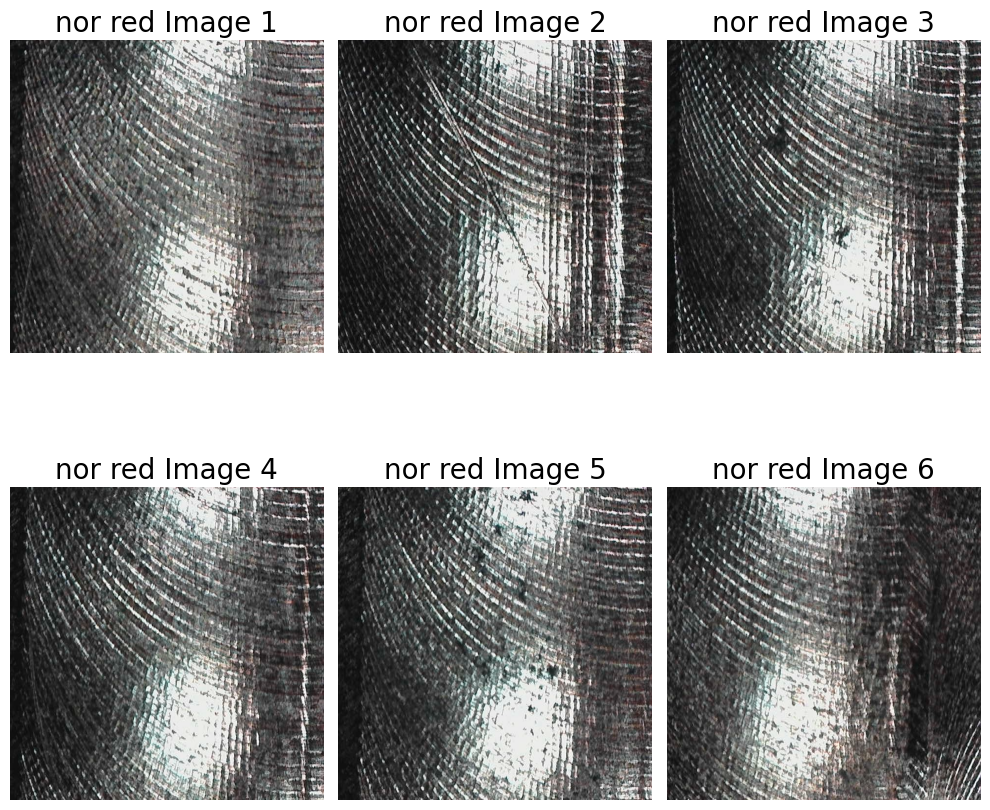

In [28]:
fig, axes = plt.subplots(2, 3, figsize=(10, 10))

# 이미지 개수에 맞춰 서브플롯에 이미지 표시
for i in range(len(wear_images)):
    row = i // 3
    col = i % 3
    
    if i >= 6:
        break
    
    axes[row, col].imshow(nor_images[i+12], extent=[0, 10, 0, 10])
    axes[row, col].set_title(f'nor red Image {i+1}',fontsize=20)
    axes[row, col].axis('off')

plt.tight_layout()
plt.show()

### `-` **다른 경로에서 발견된 마모의 흔적**

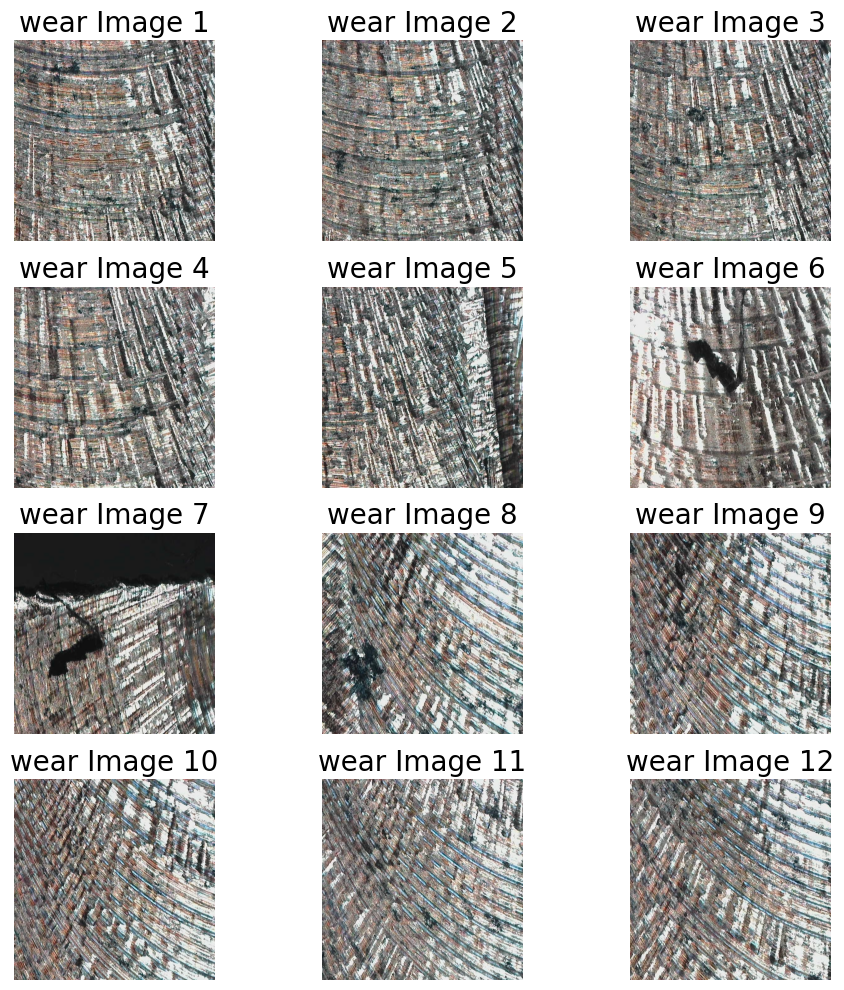

In [31]:
fig, axes = plt.subplots(4, 3, figsize=(10, 10))

# 이미지 개수에 맞춰 서브플롯에 이미지 표시
for i in range(len(wear_other_images)):
    row = i // 3
    col = i % 3
    
    
    
    axes[row, col].imshow(wear_other_images[i], extent=[0, 10, 0, 10])
    axes[row, col].set_title(f'wear Image {i+1}',fontsize=20)
    axes[row, col].axis('off')

plt.tight_layout()
plt.show()


# `-` Edge Detection(윤곽선 검출)

## `-` **정상**

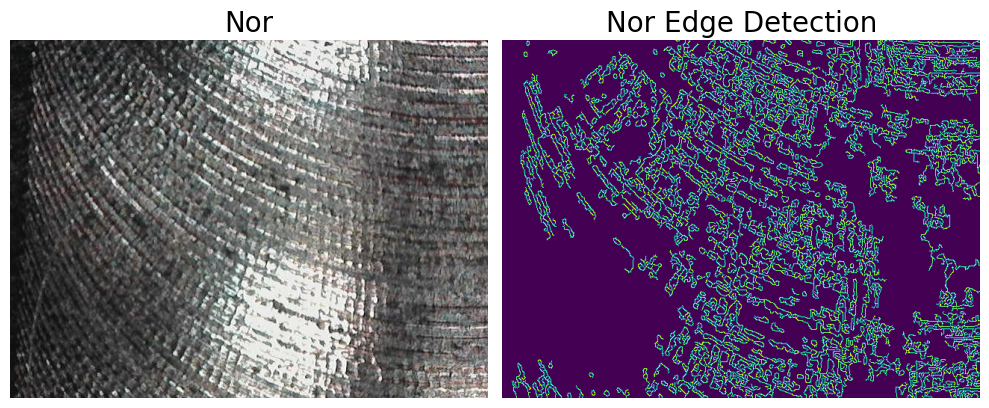

In [17]:

blurred = cv2.GaussianBlur(nor_images[11], (5, 5), 0)
#흑백변환


canny = cv2.Canny(blurred, 0,300)

fig, axes = plt.subplots(1, 2, figsize=(10, 10))

# 첫 번째 서브플롯 - nor
axes[0].imshow(nor_images[11])
axes[0].set_title('Nor',fontsize=20)
axes[0].axis('off')


# 두 번째 서브플롯 - Edge Detection
axes[1].imshow(canny)
axes[1].set_title('Nor Edge Detection',fontsize=20)
axes[1].axis('off')

plt.tight_layout()
plt.show()


## `-` **마모**

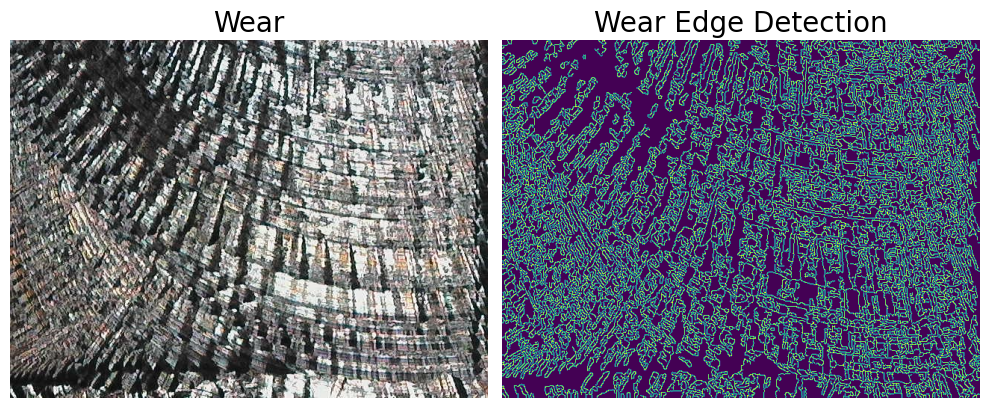

In [16]:

blurred = cv2.GaussianBlur(wear_images[11], (5, 5), 0)
#흑백변환


canny = cv2.Canny(blurred, 0,300)

fig, axes = plt.subplots(1, 2, figsize=(10, 10))

# 첫 번째 서브플롯 - nor
axes[0].imshow(wear_images[11])
axes[0].set_title('Wear',fontsize=20)
axes[0].axis('off')


# 두 번째 서브플롯 - Edge Detection
axes[1].imshow(canny)
axes[1].set_title('Wear Edge Detection',fontsize=20)
axes[1].axis('off')

plt.tight_layout()
plt.show()


# CNN

## `-` Data loader

In [55]:
path = r'C:\Users\31083\Documents\GitHub\Project\CNC_YOLOV8_Segmodel\이미지_파일\7_14'
# path = '/content/drive/MyDrive/cnn_cnc/all_blur'
files= get_image_files(path)

#라벨링 함수
def label_func(fname):
    
      if fname[0].isupper():
        return 'Fail'
      else:
        return 'normal'

dls = ImageDataLoaders.from_name_func(path, files, label_func, item_tfms=Resize(224), batch_size=16)

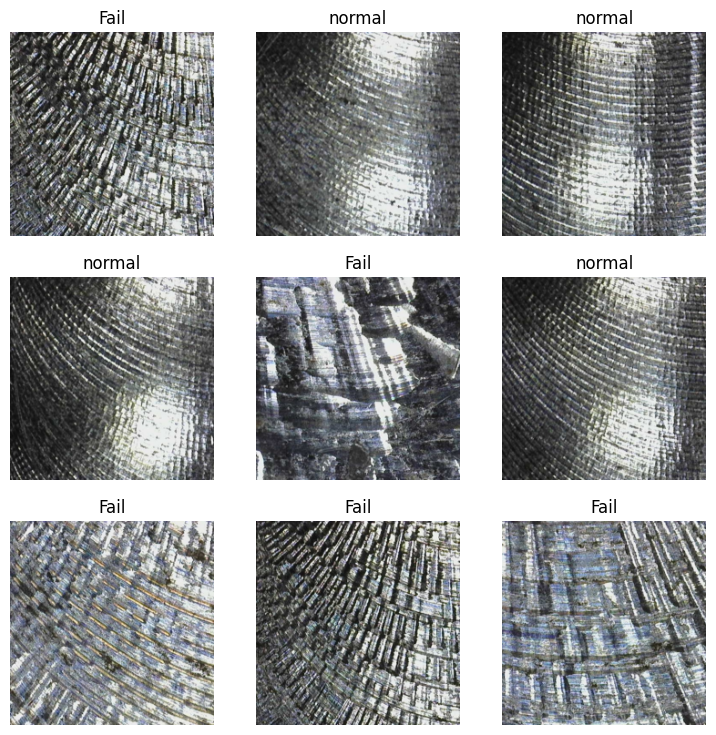

In [56]:
  # 학습 데이터셋에 대한 데이터 로더
dls.show_batch() # 첫 번째 배치의 이미지 시각화

## `-` train/vaild

C:\Users\31083\anaconda3\envs\test_envs\lib\site-packages\fastai\vision\learner.py:288: UserWarning: `cnn_learner` has been renamed to `vision_learner` -- please update your code
  warn("`cnn_learner` has been renamed to `vision_learner` -- please update your code")
C:\Users\31083\anaconda3\envs\test_envs\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\31083\anaconda3\envs\test_envs\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


epoch,train_loss,valid_loss,accuracy,time
0,1.091665,1.422651,0.444444,00:02


epoch,train_loss,valid_loss,accuracy,time
0,1.023656,0.823992,0.666667,00:03
1,0.740155,0.347775,0.888889,00:03
2,0.575353,0.145840,0.888889,00:03
3,0.492219,0.117674,0.888889,00:03
4,0.387959,0.098996,0.888889,00:03
5,0.320066,0.052978,1.000000,00:03
6,0.271619,0.023089,1.000000,00:03
7,0.235622,0.005527,1.000000,00:03
8,0.207114,0.001702,1.000000,00:03
9,0.205115,0.000663,1.000000,00:03


No improvement since epoch 9: early stopping


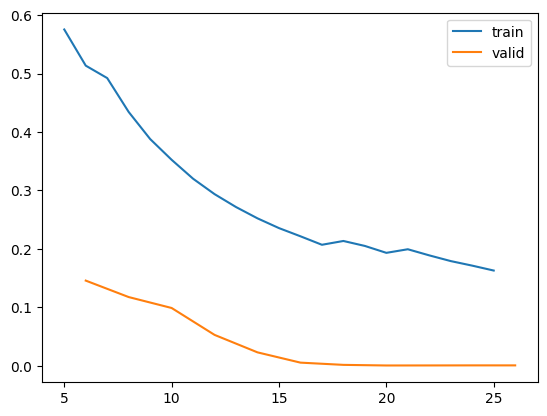

In [5]:
lrnr = cnn_learner(dls, resnet34, metrics=accuracy)
# EarlyStopping 콜백 함수 정의
early_stopping_cb = EarlyStoppingCallback(monitor='valid_loss', patience=3)

# fine-tuning 수행
lrnr.fine_tune(25, cbs=early_stopping_cb)

# 로스값 시각화
lrnr.recorder.plot_loss()

In [9]:
# 검증 데이터셋에서 모델 평가
loss, acc = lrnr.validate(dl=dls.valid)
print(f'Loss: {loss}, Accuracy: {acc}')

Loss: 0.004475961904972792, Accuracy: 1.0


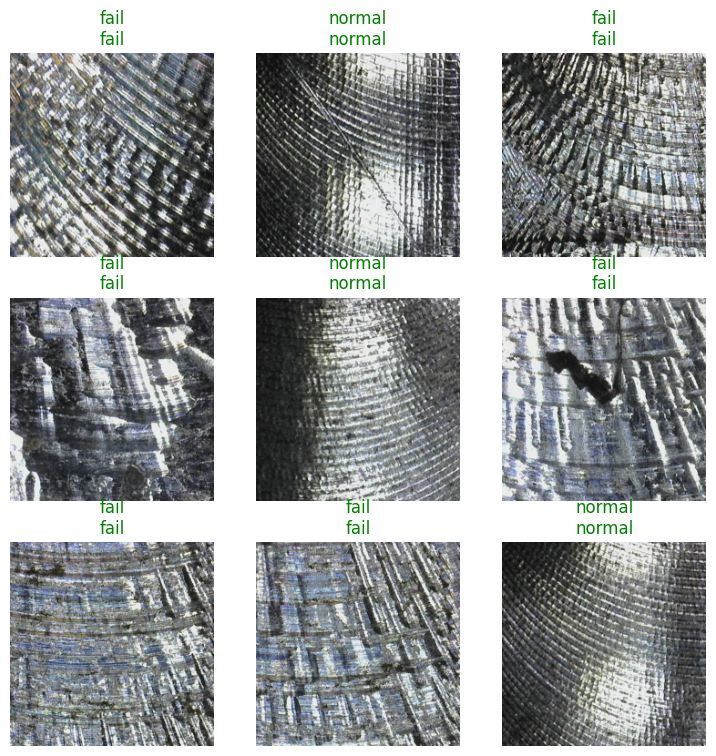

In [10]:
lrnr.show_results()

## `-` Test

('Fail', tensor(0), tensor([0.9972, 0.0028]))


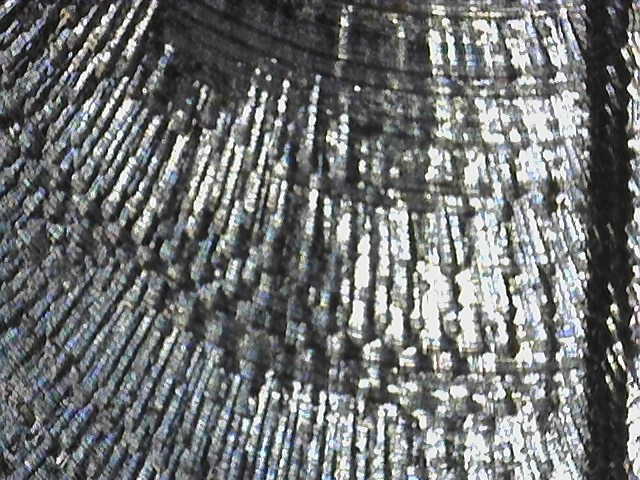

In [89]:
print(lrnr.predict(PILImage.create(test_files[2])))
PILImage.create(test_files[2])

('normal', tensor(1), tensor([7.5257e-05, 9.9992e-01]))


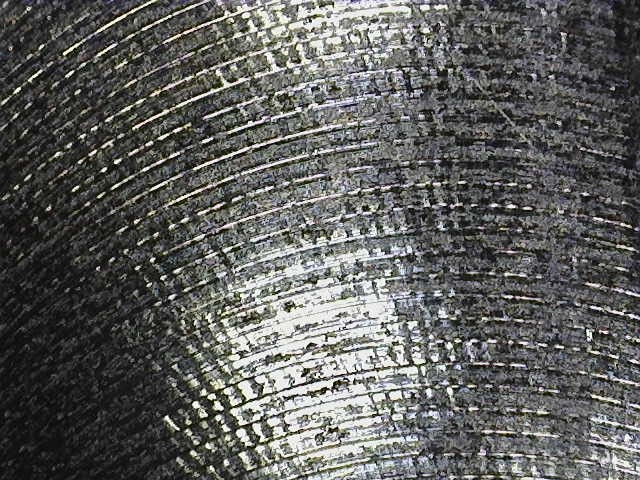

In [91]:
print(lrnr.predict(PILImage.create(test_files[6])))
PILImage.create(test_files[6])